In [1]:
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as tt
import torch
import torch.nn as nn
import cv2
from tqdm.notebook import tqdm
from torchvision.utils import save_image
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [14]:
import torch.optim as optim
from torch.autograd import Variable
import torch.utils.data as data
import random
from torchvision import transforms

from PIL import Image
from torch.optim import lr_scheduler
import os , itertools

**Обучение происходило в GoogleColab, поэтому подключим гугл-диск**

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Зададим параметры для обучения. Batch_size = 16, картинки будут обрабатываться сетью с размерами 256х256.**


**Также для нормализации входа зададим статистики std=0.5, mean=0.5 по всем трём каналам картинки.**

In [10]:
image_size = 256
batch_size = 16
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

In [17]:
transform=tt.Compose([
    tt.Resize([image_size,image_size]),
    tt.ToTensor(),
    tt.Normalize(*stats)])

In [13]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
device

#TODO: build dataloader and transfer it to device

device(type='cuda')

**Зададим класс для создания dataloader с заданным путём к папке с фотографиям, preprocessing'ом и размером батча из параметров, заданных выше.**

In [16]:
class DatasetFromFolder(data.Dataset):
    def __init__(self, image_dir, subfolder=None, transform=None, resize_scale=None):
        super(DatasetFromFolder, self).__init__()
        self.input_path = os.path.join(image_dir, subfolder)
        self.image_filenames = [x for x in sorted(os.listdir(self.input_path))]
        self.transform = transform ## преобразуем картинки по заданным параметрам
        
        self.resize_scale = resize_scale

    def __getitem__(self, index):
        # Load Image
        img_fn = os.path.join(self.input_path, self.image_filenames[index])
        img = Image.open(img_fn).convert('RGB')

        # preprocessing
        if self.resize_scale:
            img = img.resize((self.resize_scale, self.resize_scale), Image.BILINEAR)

        if self.transform is not None:
            img = self.transform(img)

        return img

    def __len__(self):
        return len(self.image_filenames)


**Зададим вспомогательные функцию и класс для перемещения данных и даталоадера на устройство**

In [19]:
def to_device(data, device): ## перенос данных на заданный девайс
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader(): ## перенос даталоадера на заданный девайс
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

**Создадим даталоадеры по картинками из заданных папок с картинками. Домен А - кадры из "Унесённых призраками", а в домене B - примеры случайных картинок.**

In [20]:
train_data_A = DatasetFromFolder('/content/drive/MyDrive/DC_GAN', subfolder='imgA', transform=transform)
train_data_loader_A = torch.utils.data.DataLoader(dataset=train_data_A, batch_size=batch_size, shuffle=True)

train_data_loader_A = DeviceDataLoader(train_data_loader_A, device)

train_data_B = DatasetFromFolder('/content/drive/MyDrive/DC_GAN', subfolder='imgB', transform=transform)
train_data_loader_B = torch.utils.data.DataLoader(dataset=train_data_A, batch_size=batch_size, shuffle=True)
train_data_loader_B = DeviceDataLoader(train_data_loader_B, device)

**Зададим архитектуру DC-GAN - дискриминатор и генератор.**

In [3]:
discriminator = nn.Sequential(
    # in: 3 x 256 x 256

    nn.Conv2d(3, 32, kernel_size=5, stride=2, padding=1, bias=False),
    nn.InstanceNorm2d(32, affine=True),
    nn.LeakyReLU(inplace=True),

    nn.Conv2d(32, 64, kernel_size=5, stride=2, padding=1, bias=False),
    nn.InstanceNorm2d(64, affine=True),
    nn.LeakyReLU(inplace=True),

    nn.Conv2d(64, 128, kernel_size=5, stride=2, padding=1, bias=False),
    nn.InstanceNorm2d(128, affine=True),
    nn.LeakyReLU(inplace=True),

    nn.Conv2d(128, 256, kernel_size=5, stride=2, padding=1, bias=False),
    nn.InstanceNorm2d(256, affine=True),
    nn.LeakyReLU(inplace=True),

    nn.Conv2d(256, 512, kernel_size=5, stride=2, padding=1, bias=False),
    nn.InstanceNorm2d(512, affine=True),
    nn.LeakyReLU(inplace=True),

    nn.Conv2d(512, 1, kernel_size=5, stride=2, padding=1, bias=False),

    nn.Conv2d(1, 1, kernel_size=3, stride=1, padding=0, bias=False),
    # out: 1 x 1 x 1

    nn.Flatten(),
    nn.Sigmoid())

In [5]:
generator = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.Conv2d(3, 128, kernel_size=5, stride=1, padding=1, bias=False),
    nn.InstanceNorm2d(128, affine=True),
    nn.LeakyReLU(inplace=True),

    nn.Conv2d(128, 64, kernel_size=5, stride=1, padding=1, bias=False),
    nn.InstanceNorm2d(64, affine=True),
    nn.LeakyReLU(inplace=True),

    nn.Conv2d(64, 64, kernel_size=5, stride=1, padding=1, bias=False),
    nn.InstanceNorm2d(64, affine=True),
    nn.LeakyReLU(inplace=True),

    nn.ConvTranspose2d(64, 64, kernel_size=5, stride=1, padding=1, bias=False),
    nn.InstanceNorm2d(64, affine=True),
    nn.LeakyReLU(inplace=True),

    nn.ConvTranspose2d(64, 128, kernel_size=5, stride=1, padding=1, bias=False),
    nn.InstanceNorm2d(128, affine=True),
    nn.LeakyReLU(inplace=True),

    nn.ConvTranspose2d(128, 3, kernel_size=5, stride=1, padding=1, bias=False),
    nn.Tanh()
    # out: 3 x 256 x 256
)

Эта ячейка нужна для дообучения. Пользовался ей, когда заканчивался сеанс на Google Colab

In [6]:
# discriminator.load_state_dict(torch.load('/content/drive/MyDrive/DC_GAN/D_B.pth'))
# generator.load_state_dict(torch.load('/content/drive/MyDrive/DC_GAN/G_B.pth'))

<All keys matched successfully>

**Обучать будем с learning rate=1e-3 и обычным среднеквадратичным лоссом (nn.MSELoss)**

In [21]:
lr = 0.001

model = {
    "discriminator": discriminator.to(device),
    "generator": generator.to(device)
}

criterion = {
    "discriminator": nn.MSELoss(),
    "generator": nn.MSELoss()
}

**Обучение**

In [23]:
def fit(model, criterion, epochs, lr, start_idx=1):
    model["discriminator"].train()
    model["generator"].train()
    
    # Losses & scores зададим списки для записи лоссов и скоров(в данном случае accuracy)
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []
    
    # Зададим оптимизаторы - для обоих моделей использовался Adaptive Momentum
    optimizer = {
        "discriminator": torch.optim.Adam(model["discriminator"].parameters(), 
                                          lr=lr, betas=(0.5, 0.999)),
        "generator": torch.optim.Adam(model["generator"].parameters(),
                                      lr=lr, betas=(0.5, 0.999))
    }
    # Каждые 15 эпох будем уменьшать градиентный шаг вдвое
    exp_lr_scheduler = lr_scheduler.StepLR(optimizer["discriminator"], step_size=15, gamma=0.5) 
    exp_lr_scheduler2 = lr_scheduler.StepLR(optimizer["generator"], step_size=15, gamma=0.5)
    for epoch in range(epochs):
        loss_d_per_epoch = []
        loss_g_per_epoch = []
        real_score_per_epoch = []
        fake_score_per_epoch = []
        dataloader_iterator = iter(train_data_loader_A)
    
        for i, dataB in enumerate(train_data_loader_B): 
            if i%10==0: print('Batch {}/97'.format(i)) ##выведем номер батча
            try:                                       ##в следующих четырёх строчках заданы итерации для домена А, чтобы батчи подгружались параллельно.
              dataA = next(dataloader_iterator)
            except StopIteration:
              dataloader_iterator = iter(train_data_loader_A)
              dataB = next(dataloader_iterator)
            dataA.to(device)
            dataB.to(device)
            # Обучим дискриминатор
            # Очистим градиенты
            optimizer["discriminator"].zero_grad()

            # В качестве "Реальных картинок" задан домен А - кадры из аниме. Для обучения зададим таргет - 1.
            real_preds = model["discriminator"](dataA)
            real_targets = torch.ones(dataA.size(0), 1, device=device)
            real_loss = criterion["discriminator"](real_preds, real_targets)
            cur_real_score = torch.mean(real_preds).item()
            
            # Сгенерируем "фейковые кадры"
            # 
            fake_images = model["generator"](dataB)

            # Пропустим сгенерированные картинки через дискриминатор. Перед этим зададим таргет - 0.
            fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
            fake_preds = model["discriminator"](fake_images)
            fake_loss = criterion["discriminator"](fake_preds, fake_targets)
            cur_fake_score = torch.mean(fake_preds).item()

            real_score_per_epoch.append(cur_real_score)
            fake_score_per_epoch.append(cur_fake_score)

            # Обновим веса модели
            loss_d = real_loss + fake_loss
            loss_d.backward()
            optimizer["discriminator"].step()
            loss_d_per_epoch.append(loss_d.item())


            # Обучим генератор
            # Очистим градиенты
            optimizer["generator"].zero_grad()
            
            # Генерация картинок
            fake_images = model["generator"](dataB)
            
            # Попробуем обмануть генетор и вычислим лосс
            preds = model["discriminator"](fake_images)
            targets = torch.ones(dataA.size(0), 1, device=device)
            loss_g = criterion["generator"](preds, targets)
            
            # Обновим веса модели
            loss_g.backward()
            optimizer["generator"].step()
            loss_g_per_epoch.append(loss_g.item())
            
            # После прохода по батчу очистим кэш.
            torch.cuda.empty_cache()
            
        # Запишем лоссы и скоры
        losses_g.append(np.mean(loss_g_per_epoch))
        losses_d.append(np.mean(loss_d_per_epoch))
        real_scores.append(np.mean(real_score_per_epoch))
        fake_scores.append(np.mean(fake_score_per_epoch))

        #Визуализация результатов
        plot_train_result(dataB, fake_images, epoch)

        #save models
        torch.save(model["generator"].state_dict(), '/content/drive/MyDrive/DC_GAN/G_B.pth')
        torch.save(model["discriminator"].state_dict(), '/content/drive/MyDrive/DC_GAN/D_B.pth')
        

        # Выведем результаты для эпохи
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, 
            losses_g[-1], losses_d[-1], real_scores[-1], fake_scores[-1]))
    
    
    return losses_g, losses_d, real_scores, fake_scores

**Зададим функции для визуализации результатов (перед выводом картинки денормируются**

In [24]:
def to_np(x):
    return x.data.cpu().numpy()
def plot_train_result(real_image, gen_image, epoch, save=False,  show=True, fig_size=(10, 10)):
    fig, axes = plt.subplots(2, 2, figsize=fig_size)
    # print(real_image.shape, gen_image.shape)
    imgs = [to_np(real_image[0]), to_np(real_image[1]),
            to_np(gen_image[0]), to_np(gen_image[1])]
    for ax, img in zip(axes.flatten(), imgs):
        ax.axis('off')
        #ax.set_adjustable('box-forced')
        # Scale to 0-255
        img = img.squeeze()
        img = (((img - img.min()) * 255) / (img.max() - img.min())).transpose(1, 2, 0).astype(np.uint8)
        ax.imshow(img, cmap=None, aspect='equal')
    plt.subplots_adjust(wspace=0, hspace=0)

    title = 'Epoch {0}'.format(epoch + 1)
    fig.text(0.5, 0.04, title, ha='center')

    # save figure
    if save:
        save_fn = '/content/drive/MyDrive/DC_GAN/results/Result_epoch_{:d}'.format(epoch+1) + '.png'
        plt.savefig(save_fn)

    if show:
        plt.show()
    else:
        plt.close()

**Обучим модель**

- перед этим модель была обучена на 20 эпохах. Далее дообучается ещё на 58. Общее время обучения на 78 эпох около 5 часов**

Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


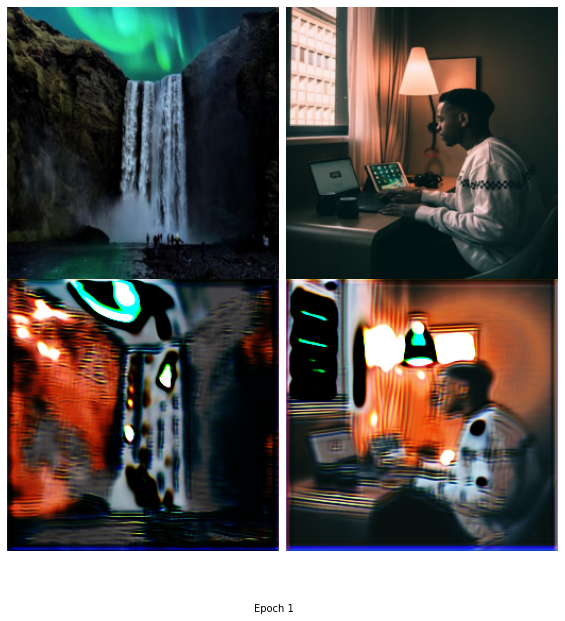

Epoch [1/100], loss_g: 0.7513, loss_d: 0.3309, real_score: 0.6925, fake_score: 0.2939
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


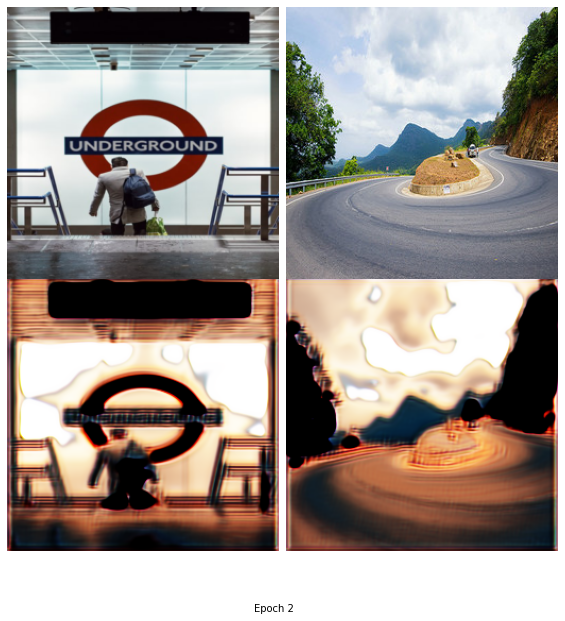

Epoch [2/100], loss_g: 0.7594, loss_d: 0.3301, real_score: 0.6975, fake_score: 0.2967
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


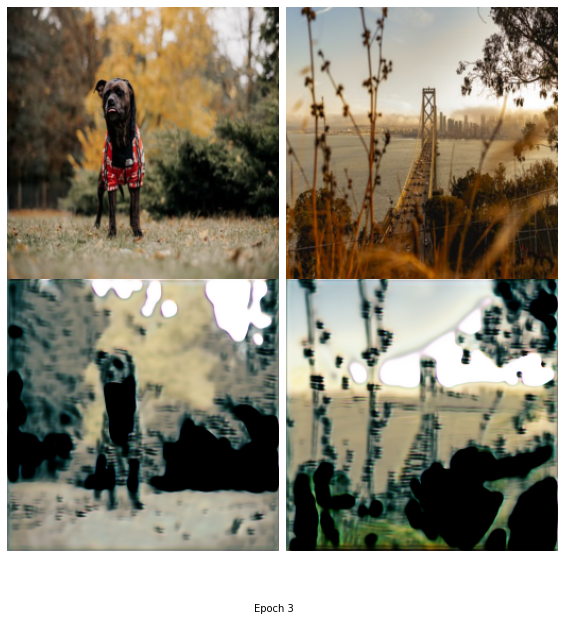

Epoch [3/100], loss_g: 0.7193, loss_d: 0.3213, real_score: 0.6863, fake_score: 0.3059
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


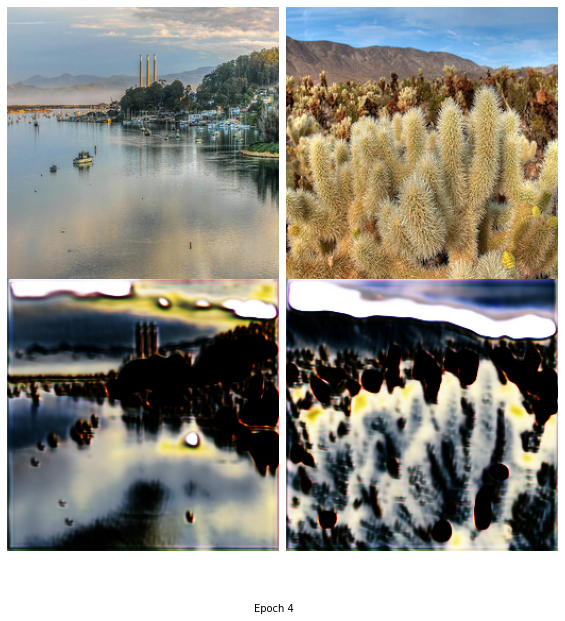

Epoch [4/100], loss_g: 0.7368, loss_d: 0.3094, real_score: 0.6973, fake_score: 0.2965
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


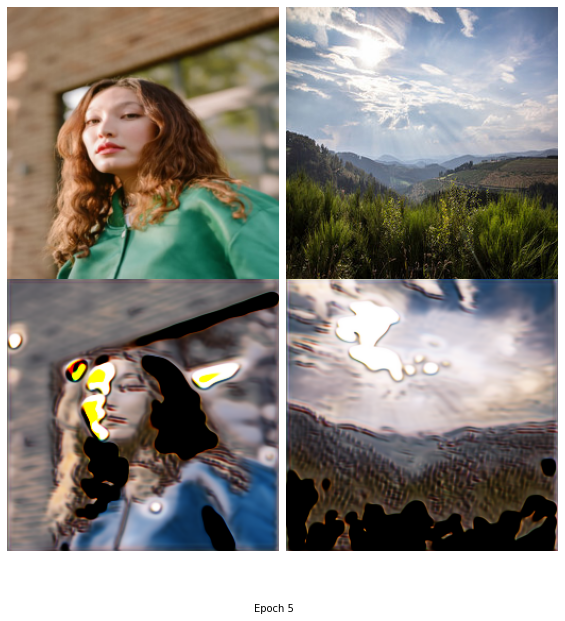

Epoch [5/100], loss_g: 0.6975, loss_d: 0.3397, real_score: 0.6705, fake_score: 0.3207
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


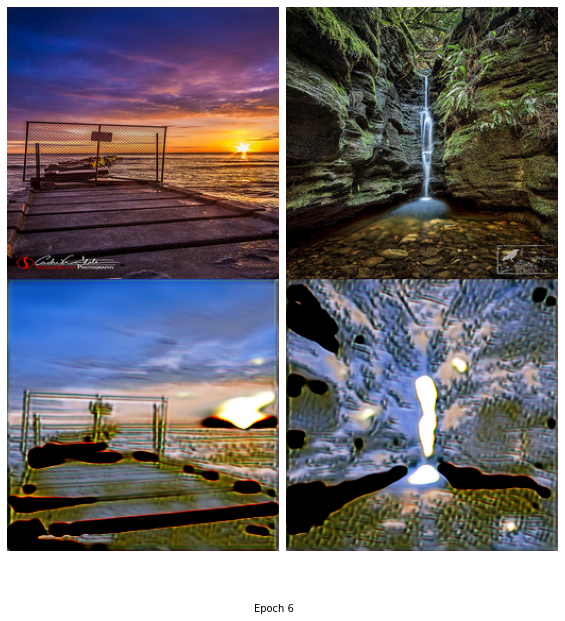

Epoch [6/100], loss_g: 0.7384, loss_d: 0.2973, real_score: 0.6951, fake_score: 0.2892
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


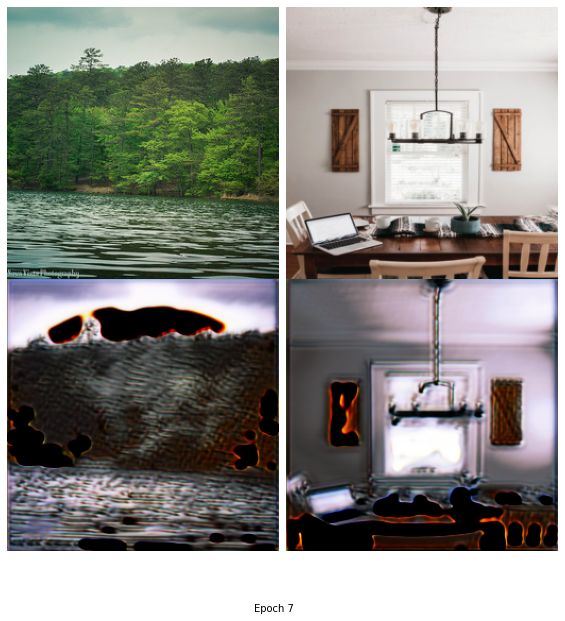

Epoch [7/100], loss_g: 0.7308, loss_d: 0.2951, real_score: 0.7042, fake_score: 0.2935
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


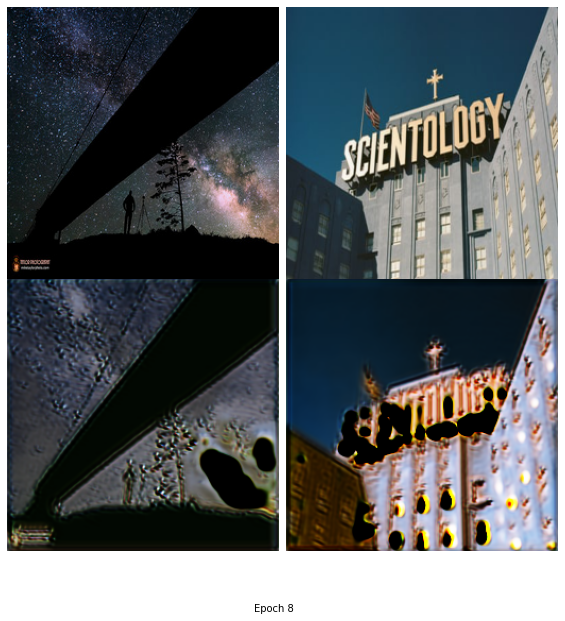

Epoch [8/100], loss_g: 0.7795, loss_d: 0.2432, real_score: 0.7419, fake_score: 0.2542
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


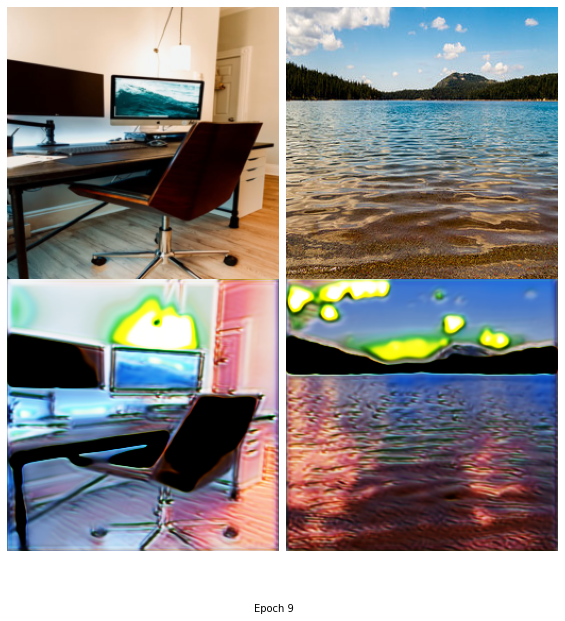

Epoch [9/100], loss_g: 0.7943, loss_d: 0.2426, real_score: 0.7518, fake_score: 0.2416
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


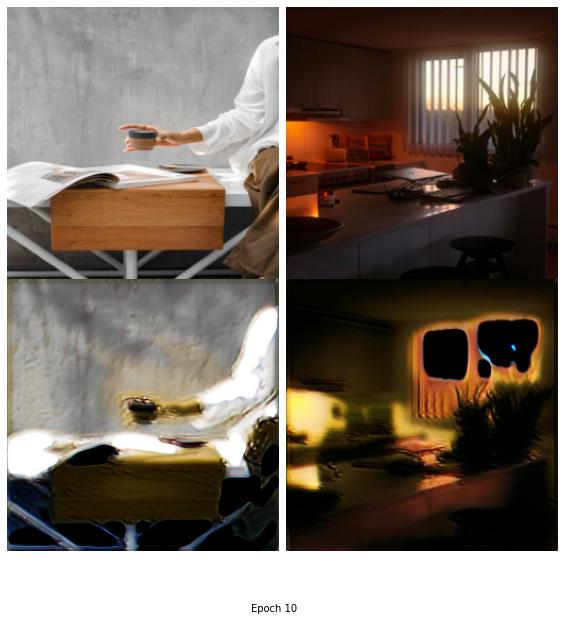

Epoch [10/100], loss_g: 0.8220, loss_d: 0.2227, real_score: 0.7777, fake_score: 0.2259
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


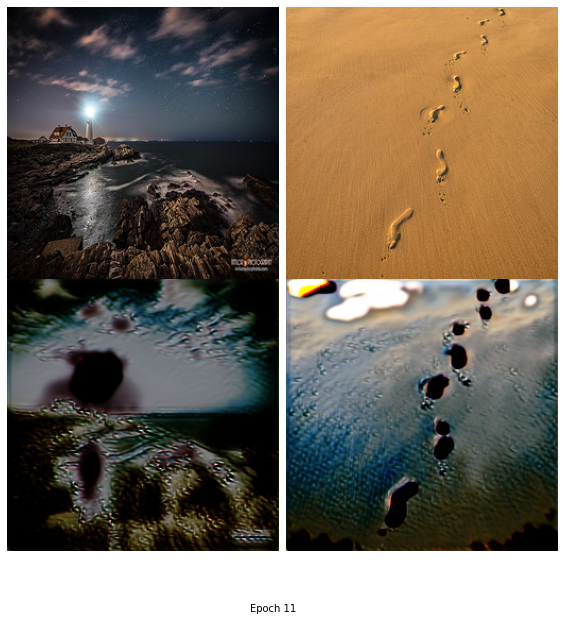

Epoch [11/100], loss_g: 0.8049, loss_d: 0.2257, real_score: 0.7683, fake_score: 0.2395
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


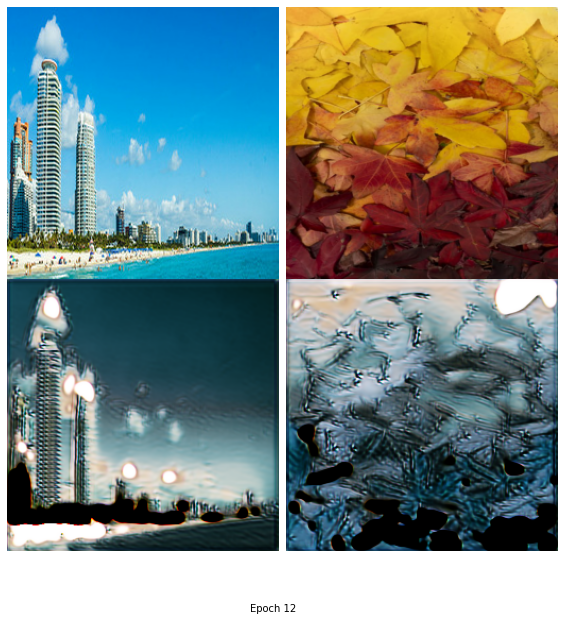

Epoch [12/100], loss_g: 0.8567, loss_d: 0.1694, real_score: 0.8119, fake_score: 0.1904
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


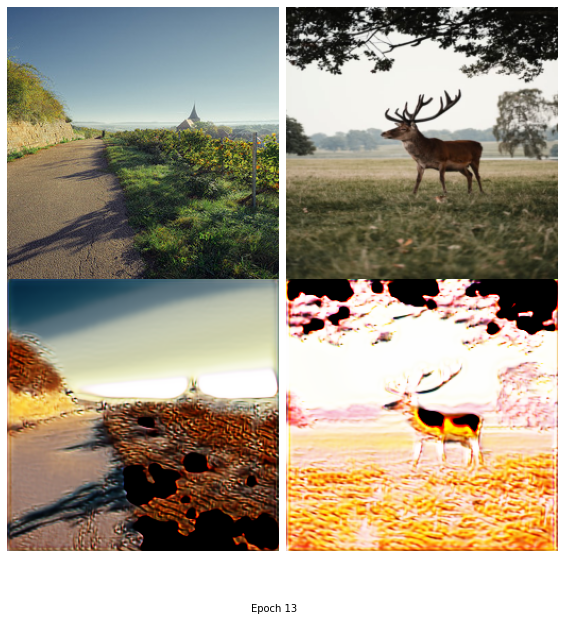

Epoch [13/100], loss_g: 0.8556, loss_d: 0.1914, real_score: 0.8050, fake_score: 0.2011
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


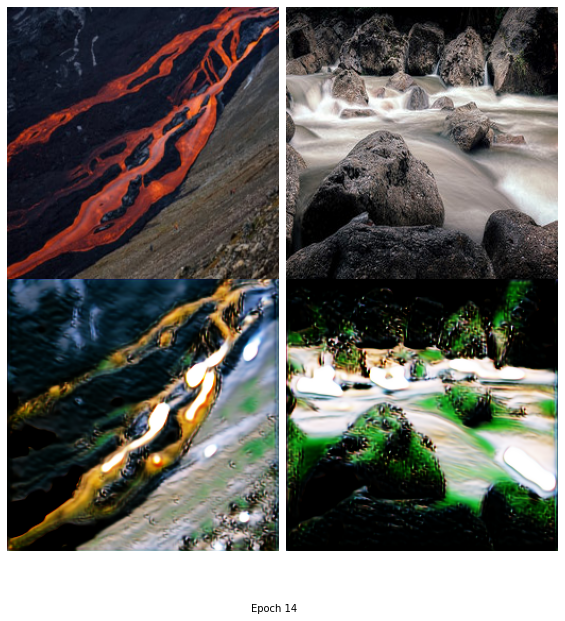

Epoch [14/100], loss_g: 0.8836, loss_d: 0.1408, real_score: 0.8460, fake_score: 0.1619
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


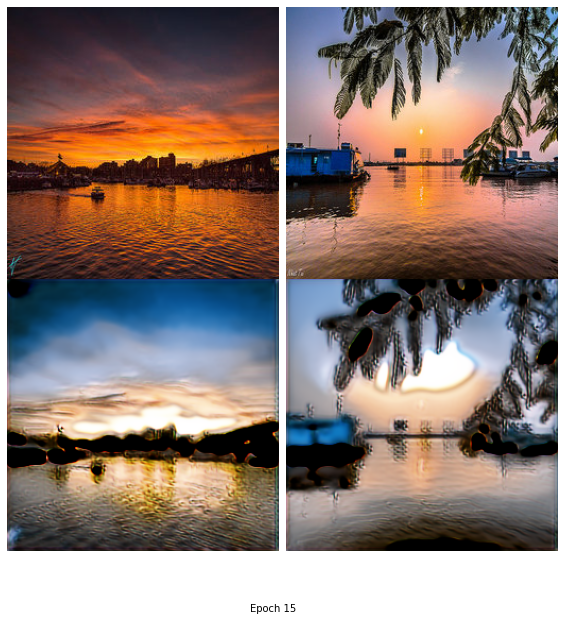

Epoch [15/100], loss_g: 0.8709, loss_d: 0.1811, real_score: 0.8162, fake_score: 0.1869
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


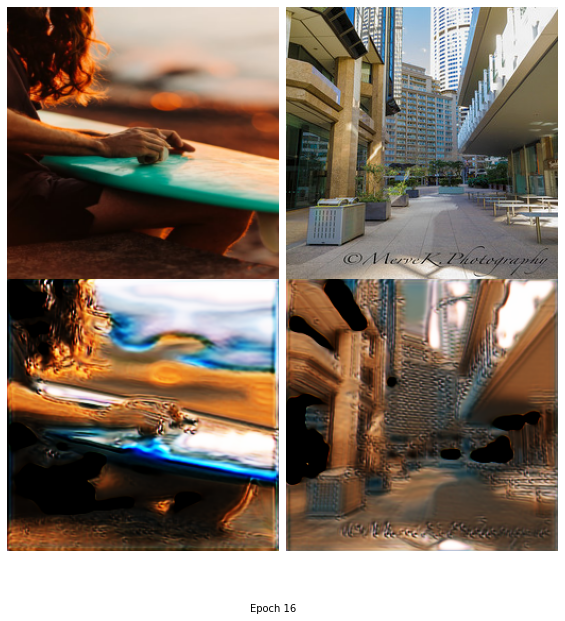

Epoch [16/100], loss_g: 0.9015, loss_d: 0.1379, real_score: 0.8585, fake_score: 0.1551
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


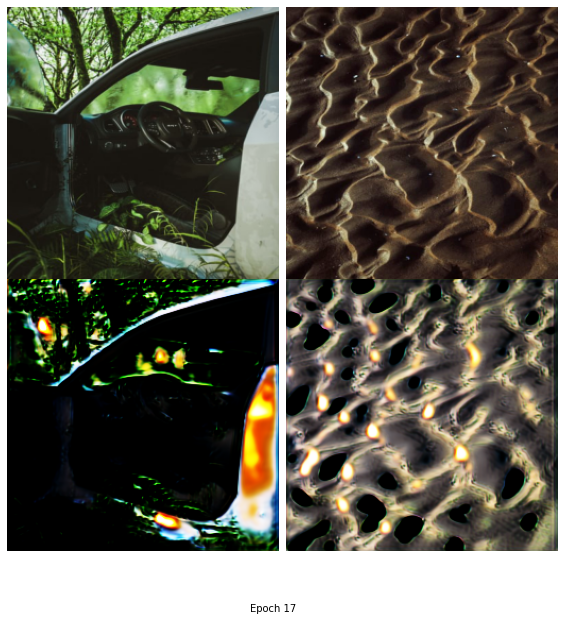

Epoch [17/100], loss_g: 0.8910, loss_d: 0.1558, real_score: 0.8393, fake_score: 0.1717
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


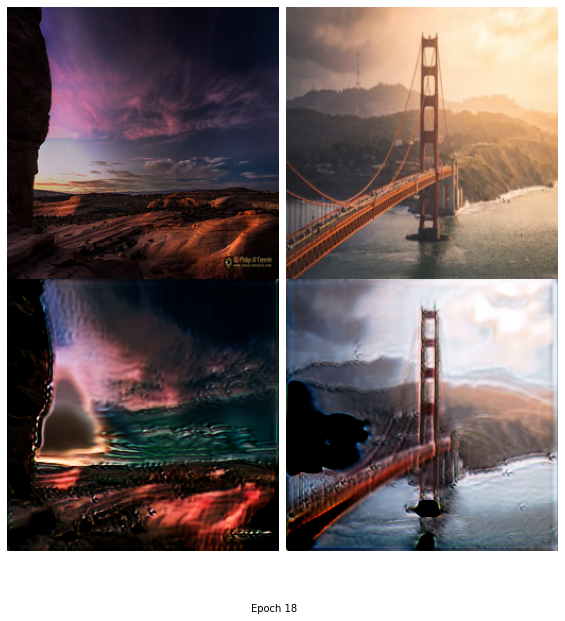

Epoch [18/100], loss_g: 0.9053, loss_d: 0.1394, real_score: 0.8594, fake_score: 0.1495
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


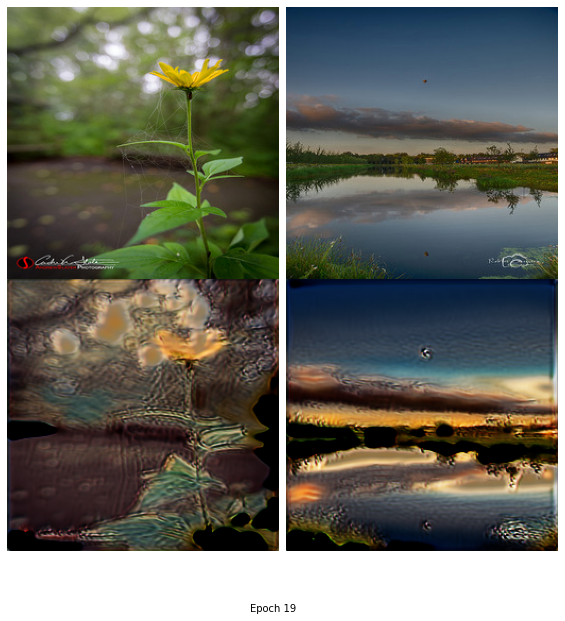

Epoch [19/100], loss_g: 0.8504, loss_d: 0.2452, real_score: 0.7922, fake_score: 0.2313
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


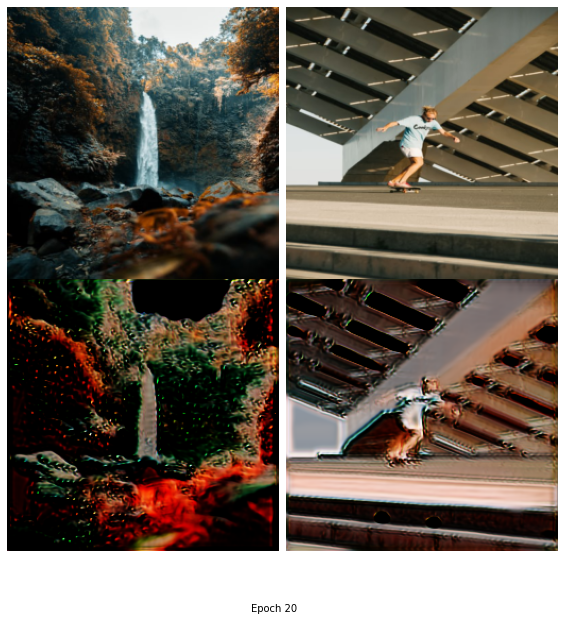

Epoch [20/100], loss_g: 0.8345, loss_d: 0.2618, real_score: 0.7571, fake_score: 0.2496
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


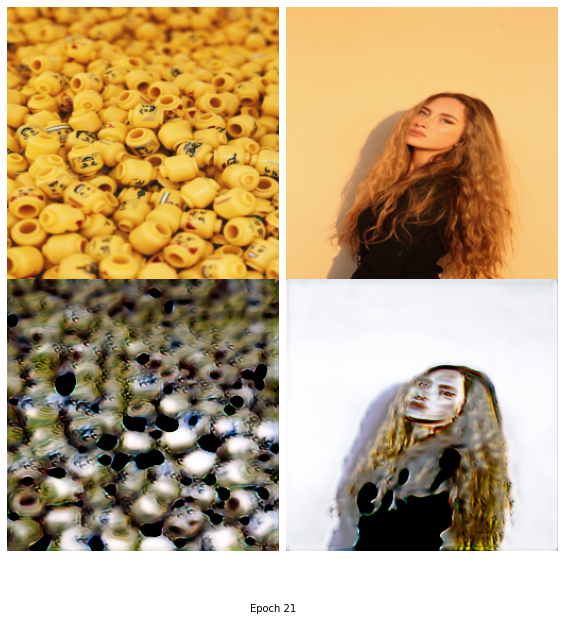

Epoch [21/100], loss_g: 0.8271, loss_d: 0.2648, real_score: 0.7489, fake_score: 0.2523
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


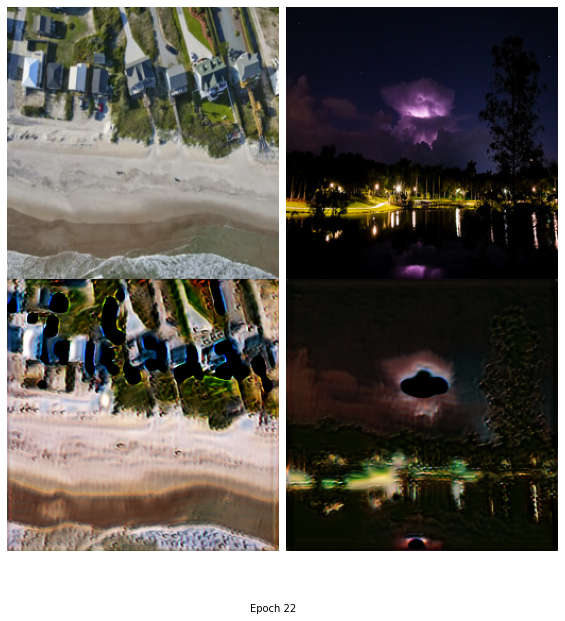

Epoch [22/100], loss_g: 0.8092, loss_d: 0.2661, real_score: 0.7479, fake_score: 0.2628
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


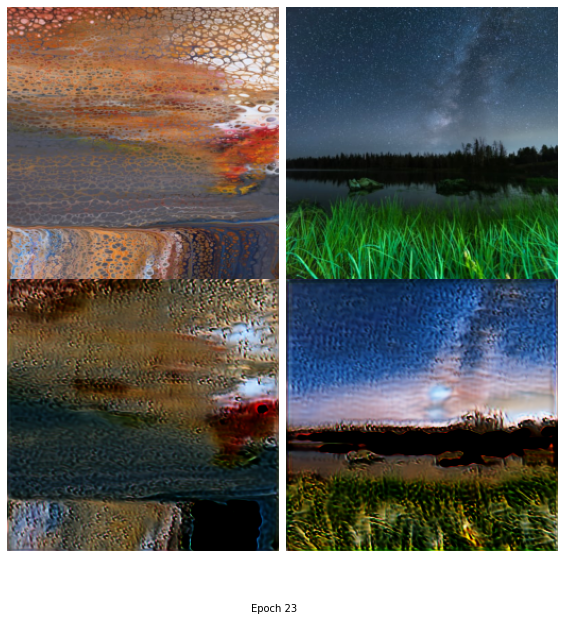

Epoch [23/100], loss_g: 0.8271, loss_d: 0.2645, real_score: 0.7447, fake_score: 0.2552
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


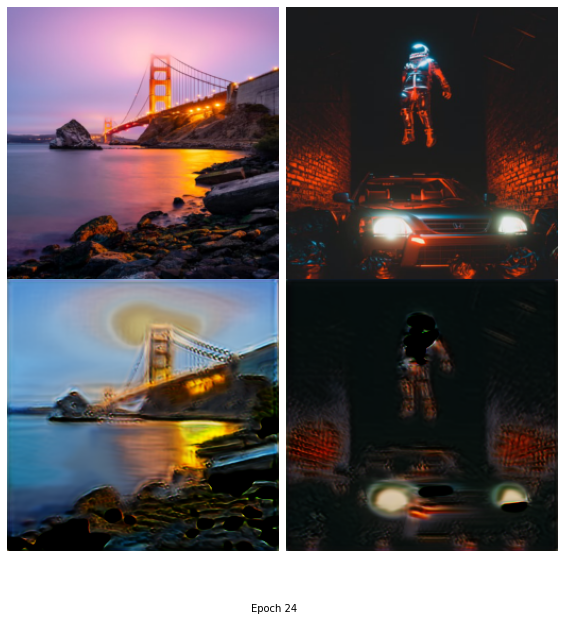

Epoch [24/100], loss_g: 0.8140, loss_d: 0.2599, real_score: 0.7491, fake_score: 0.2580
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


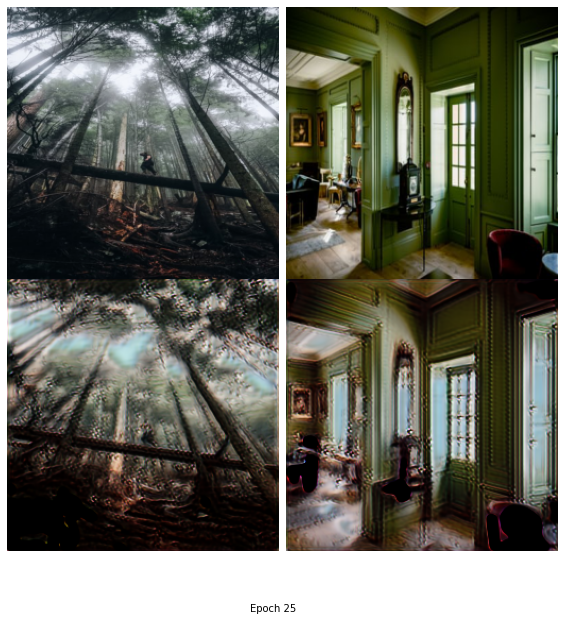

Epoch [25/100], loss_g: 0.8307, loss_d: 0.2338, real_score: 0.7600, fake_score: 0.2395
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


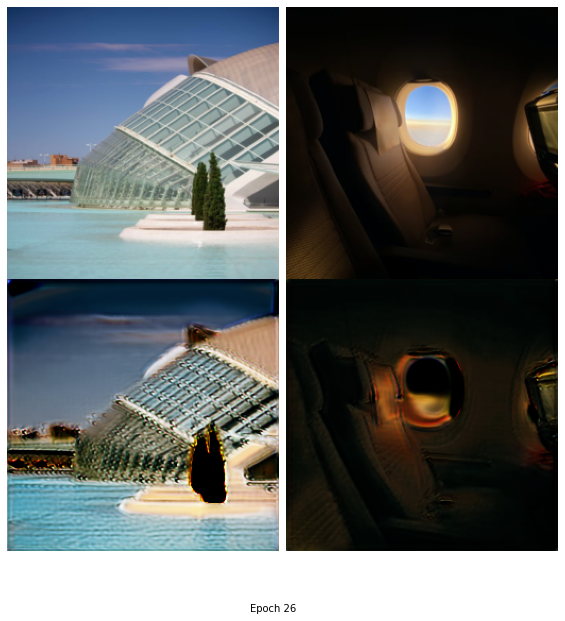

Epoch [26/100], loss_g: 0.8329, loss_d: 0.2144, real_score: 0.7774, fake_score: 0.2316
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


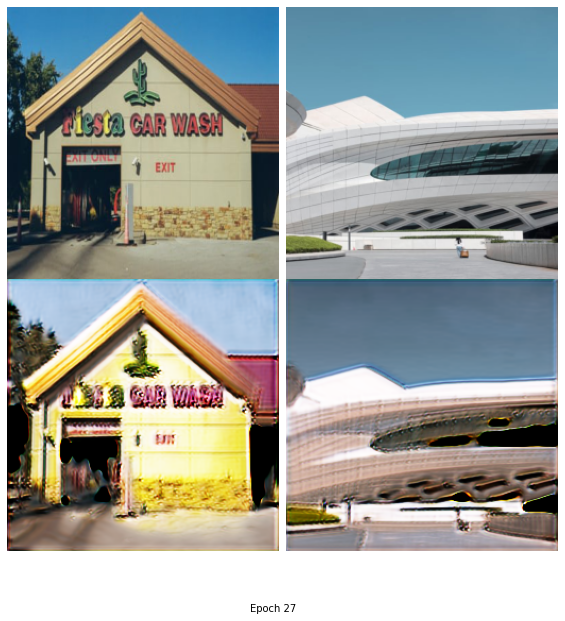

Epoch [27/100], loss_g: 0.8559, loss_d: 0.2174, real_score: 0.7770, fake_score: 0.2238
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


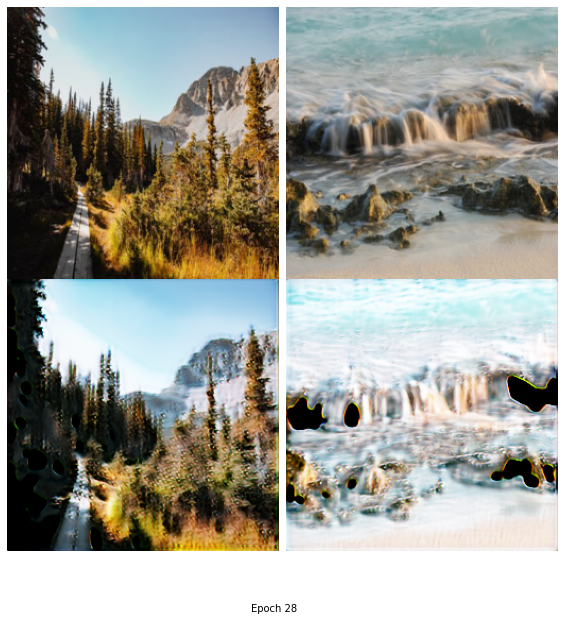

Epoch [28/100], loss_g: 0.8380, loss_d: 0.2123, real_score: 0.7917, fake_score: 0.2260
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


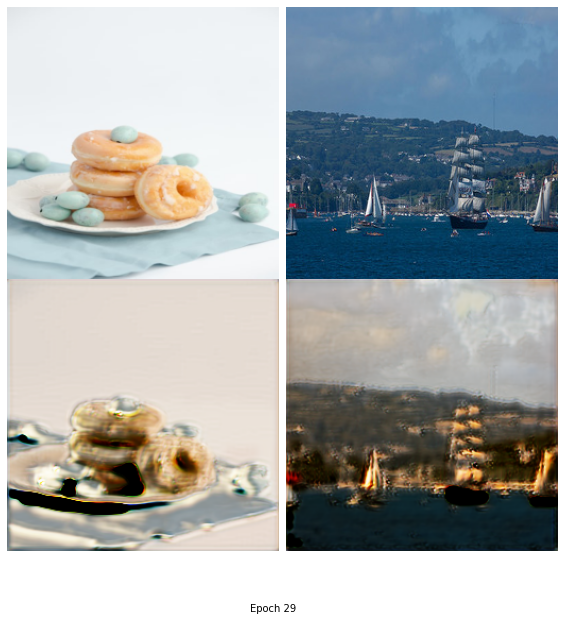

Epoch [29/100], loss_g: 0.8531, loss_d: 0.2306, real_score: 0.7734, fake_score: 0.2317
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


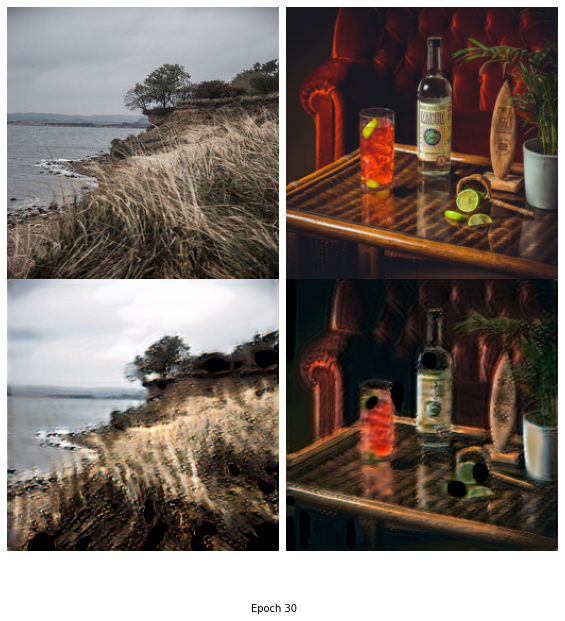

Epoch [30/100], loss_g: 0.8643, loss_d: 0.2054, real_score: 0.7942, fake_score: 0.2159
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


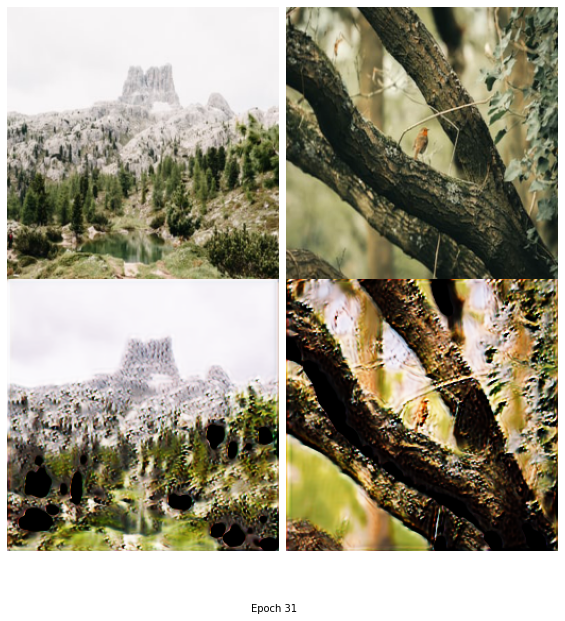

Epoch [31/100], loss_g: 0.8631, loss_d: 0.2105, real_score: 0.7922, fake_score: 0.2127
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


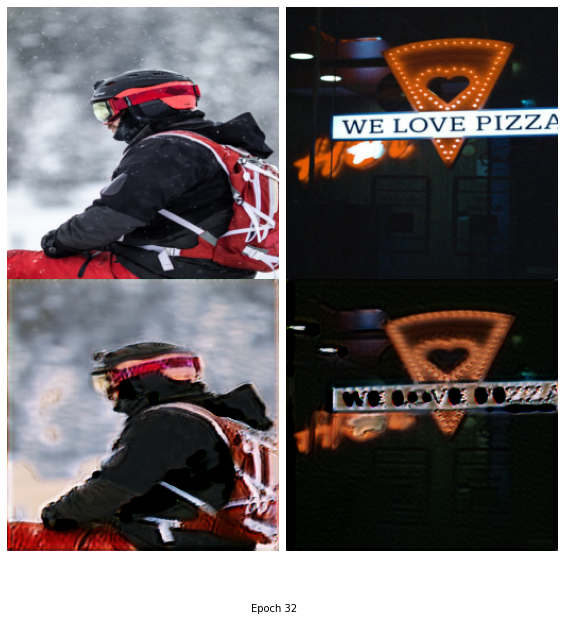

Epoch [32/100], loss_g: 0.8718, loss_d: 0.1980, real_score: 0.7980, fake_score: 0.2133
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


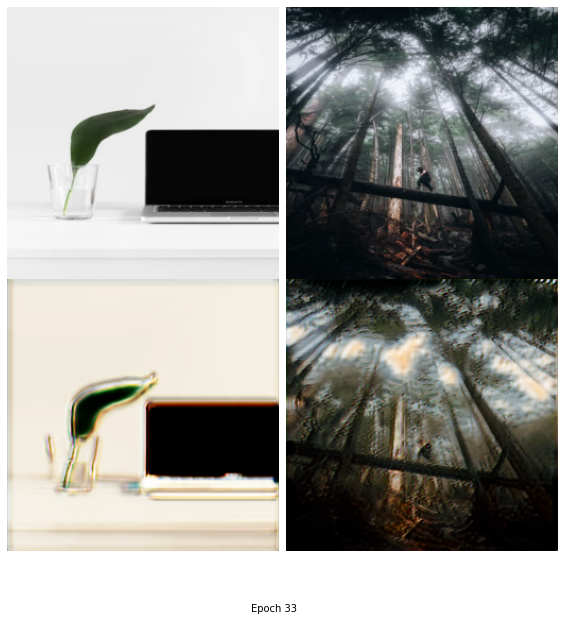

Epoch [33/100], loss_g: 0.8678, loss_d: 0.2132, real_score: 0.7988, fake_score: 0.2179
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


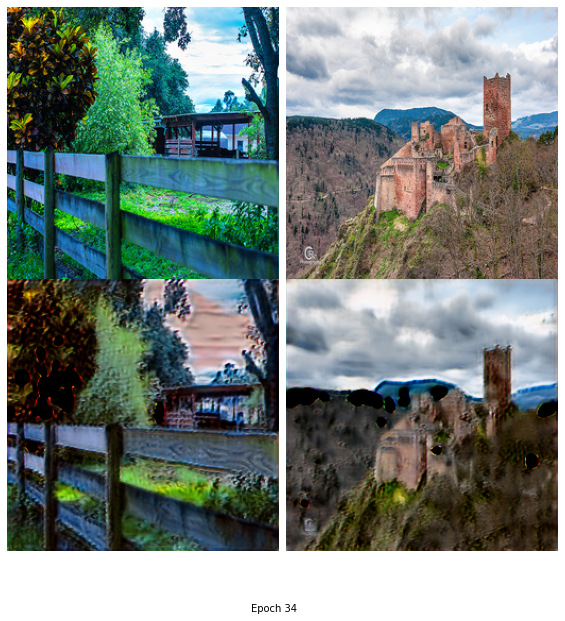

Epoch [34/100], loss_g: 0.8885, loss_d: 0.1669, real_score: 0.8300, fake_score: 0.1827
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


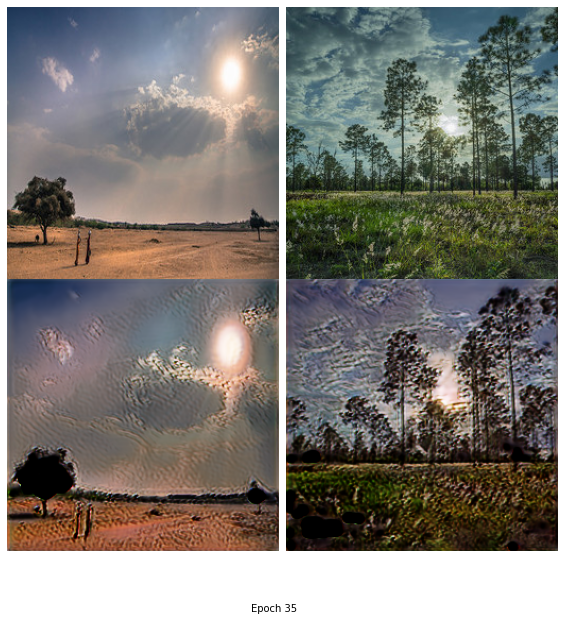

Epoch [35/100], loss_g: 0.8949, loss_d: 0.1769, real_score: 0.8184, fake_score: 0.1839
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


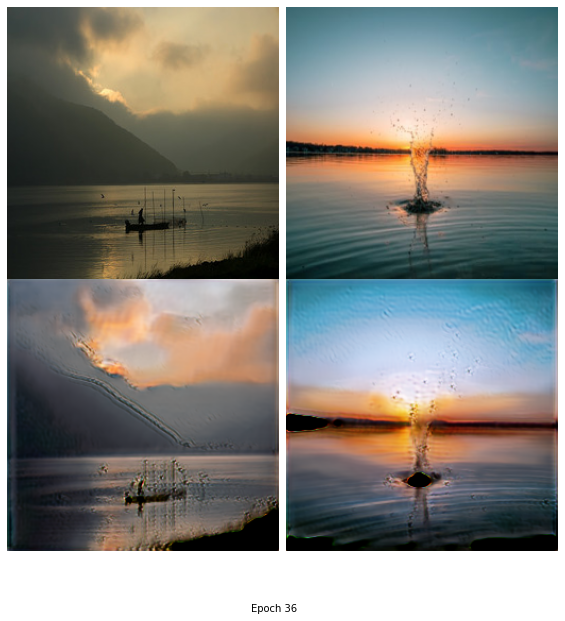

Epoch [36/100], loss_g: 0.8942, loss_d: 0.1870, real_score: 0.8162, fake_score: 0.1889
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


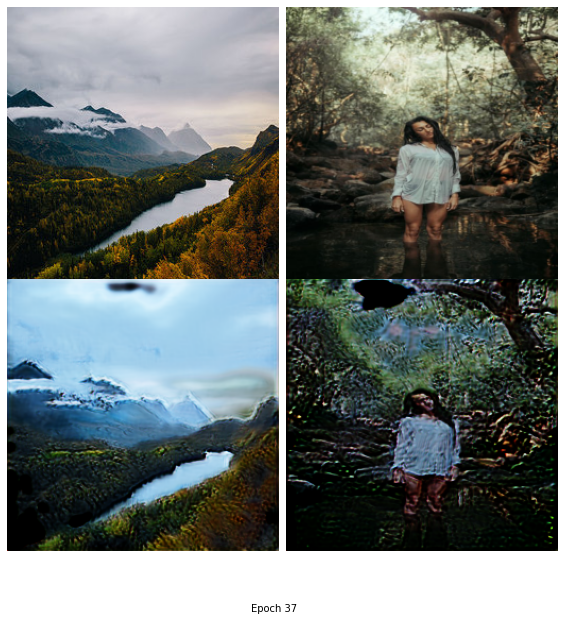

Epoch [37/100], loss_g: 0.8970, loss_d: 0.1764, real_score: 0.8234, fake_score: 0.1800
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


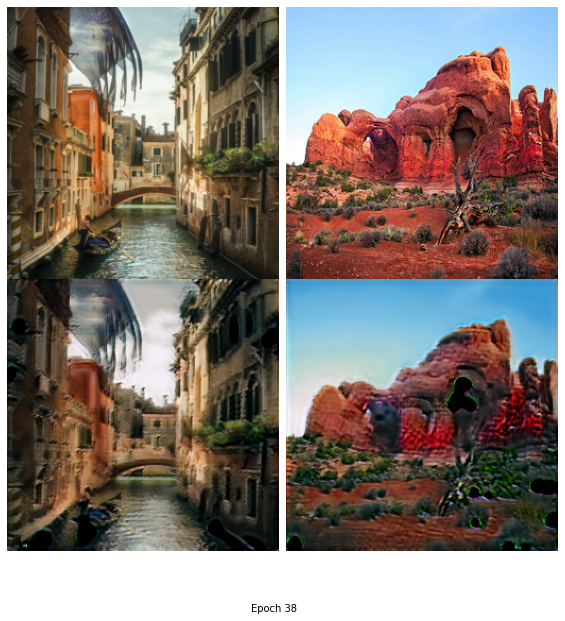

Epoch [38/100], loss_g: 0.9054, loss_d: 0.1578, real_score: 0.8388, fake_score: 0.1621
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


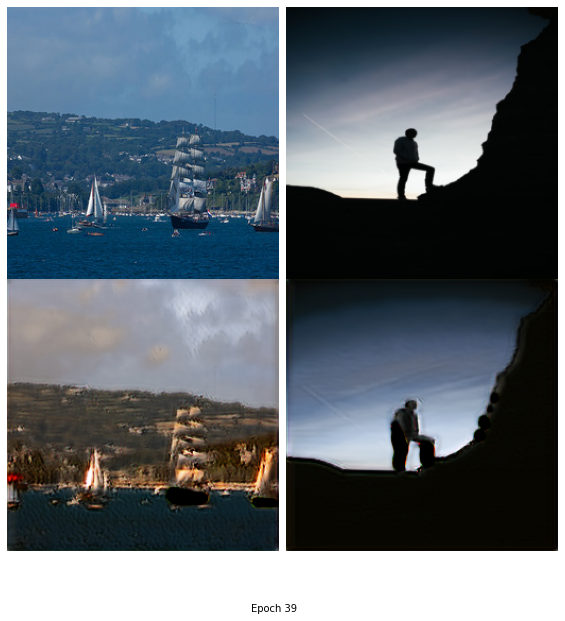

Epoch [39/100], loss_g: 0.8960, loss_d: 0.1765, real_score: 0.8295, fake_score: 0.1823
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


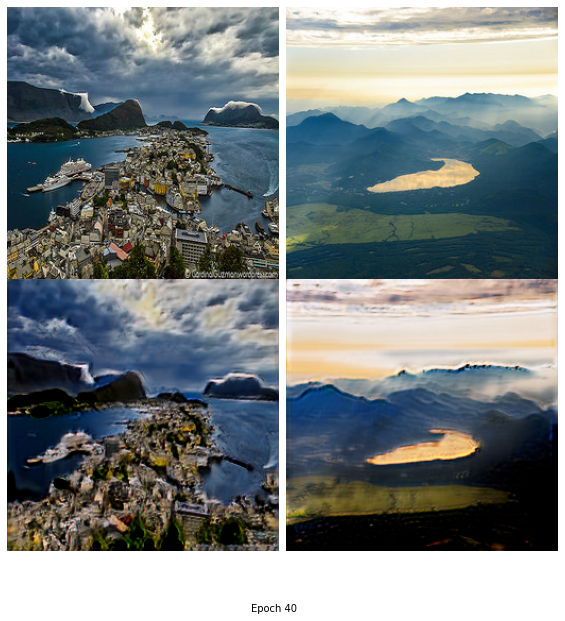

Epoch [40/100], loss_g: 0.9031, loss_d: 0.1685, real_score: 0.8335, fake_score: 0.1743
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


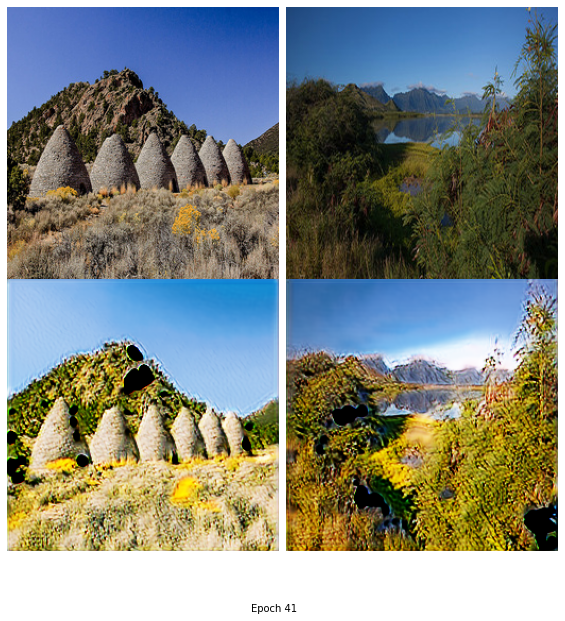

Epoch [41/100], loss_g: 0.9034, loss_d: 0.1723, real_score: 0.8297, fake_score: 0.1812
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


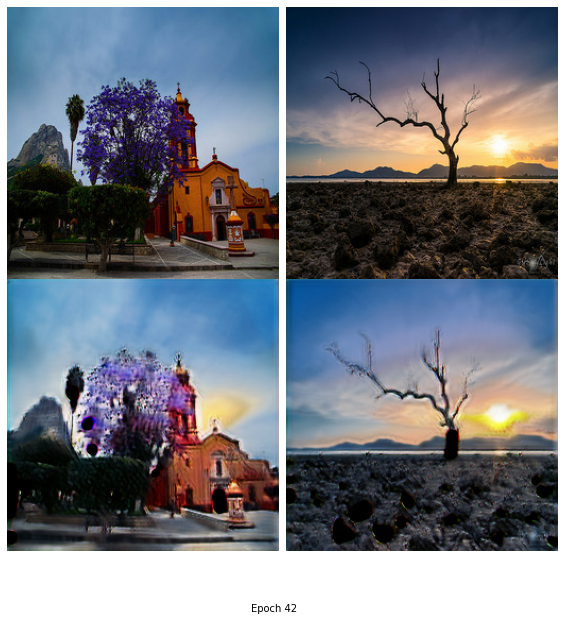

Epoch [42/100], loss_g: 0.9079, loss_d: 0.1625, real_score: 0.8400, fake_score: 0.1672
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


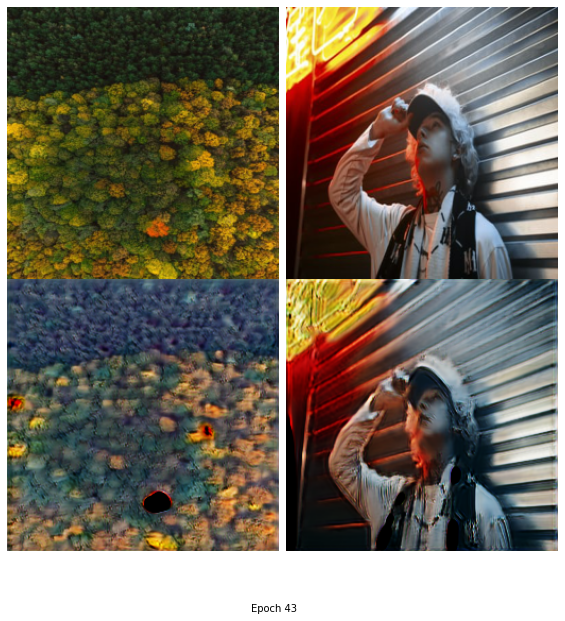

Epoch [43/100], loss_g: 0.9078, loss_d: 0.1626, real_score: 0.8390, fake_score: 0.1643
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


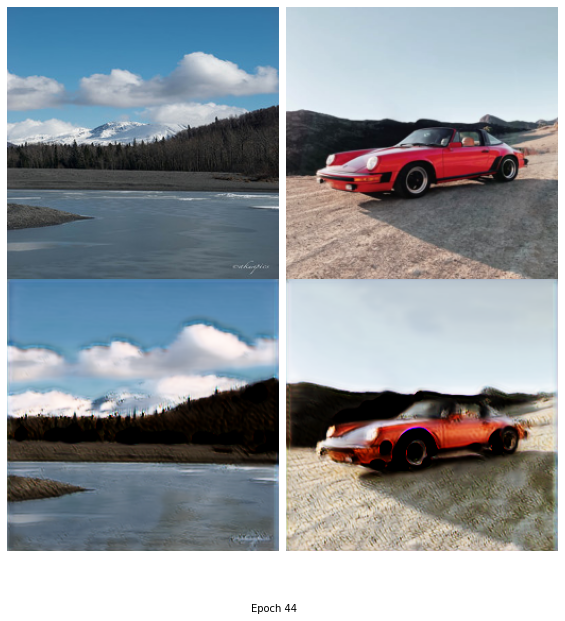

Epoch [44/100], loss_g: 0.9076, loss_d: 0.1537, real_score: 0.8529, fake_score: 0.1613
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


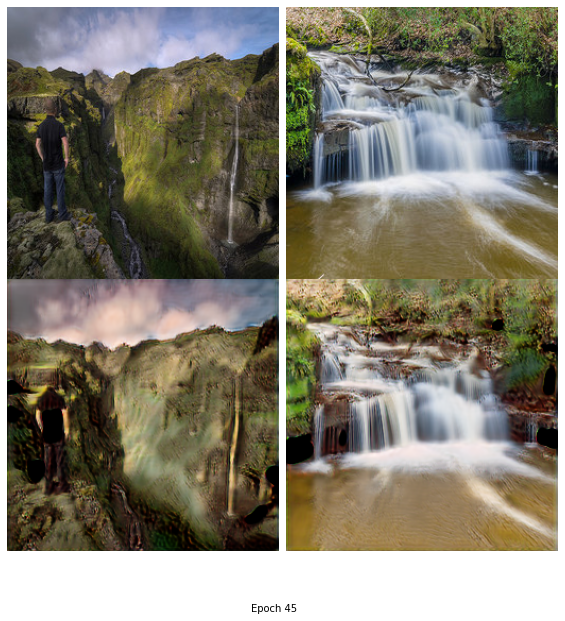

Epoch [45/100], loss_g: 0.9193, loss_d: 0.1522, real_score: 0.8470, fake_score: 0.1558
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


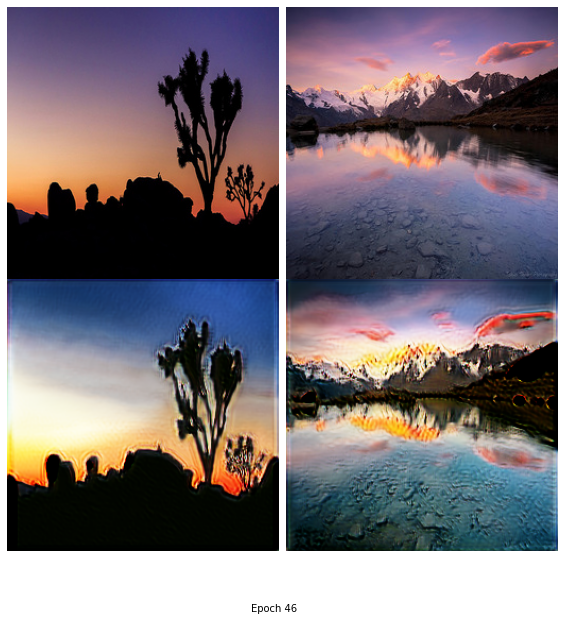

Epoch [46/100], loss_g: 0.9157, loss_d: 0.1590, real_score: 0.8468, fake_score: 0.1624
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


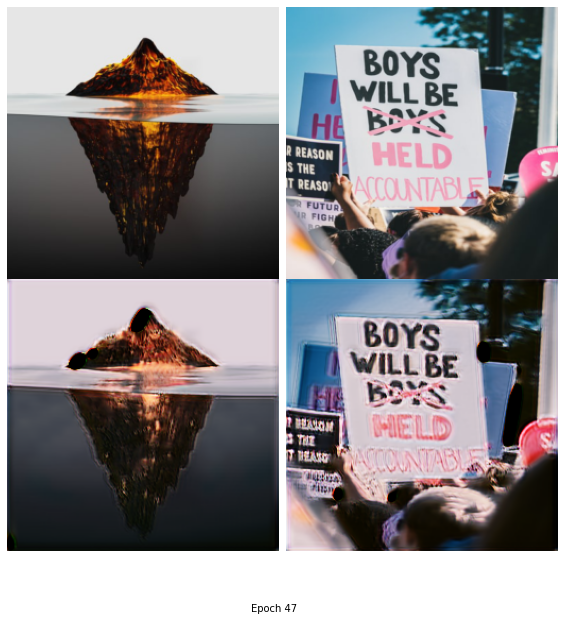

Epoch [47/100], loss_g: 0.9197, loss_d: 0.1582, real_score: 0.8421, fake_score: 0.1561
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


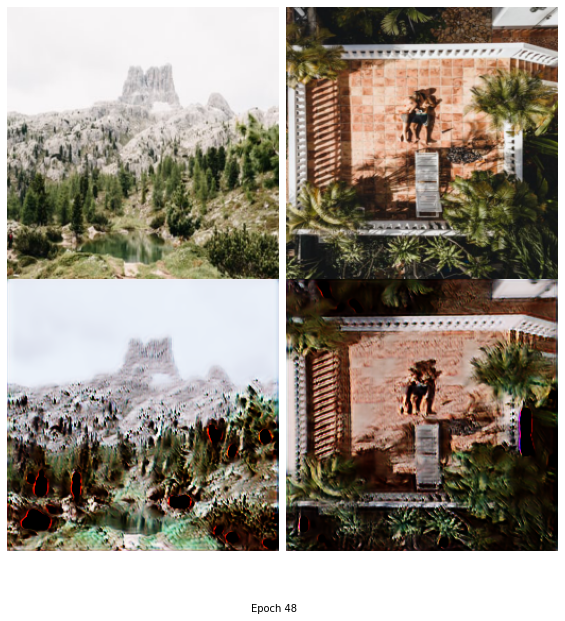

Epoch [48/100], loss_g: 0.9180, loss_d: 0.1477, real_score: 0.8508, fake_score: 0.1514
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


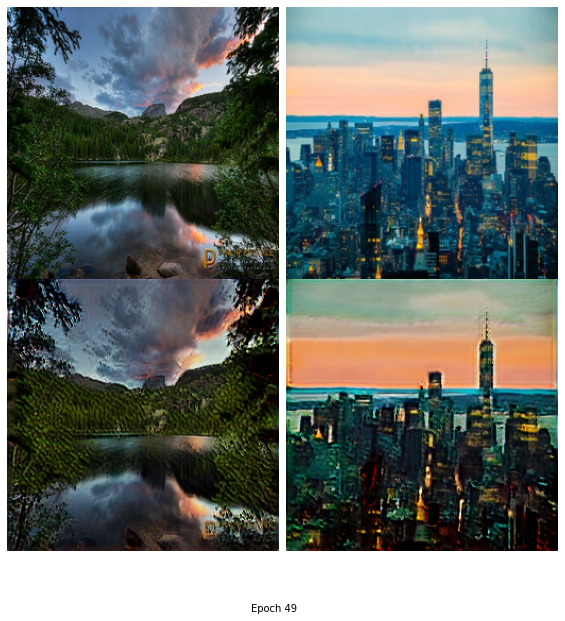

Epoch [49/100], loss_g: 0.9239, loss_d: 0.1376, real_score: 0.8581, fake_score: 0.1403
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


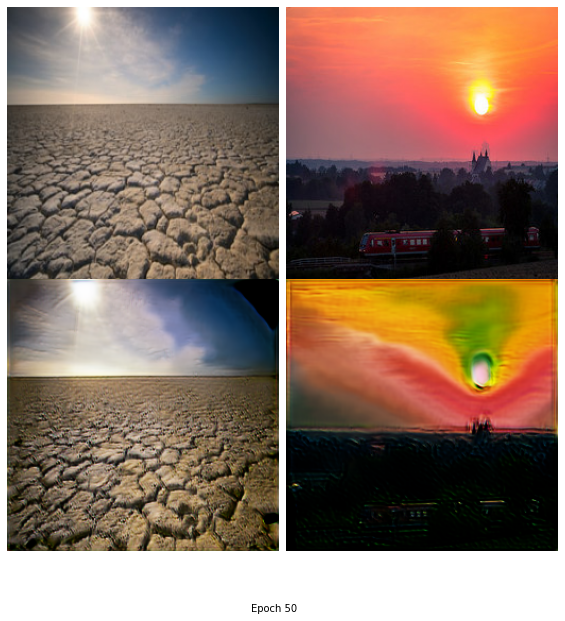

Epoch [50/100], loss_g: 0.9279, loss_d: 0.1264, real_score: 0.8646, fake_score: 0.1291
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


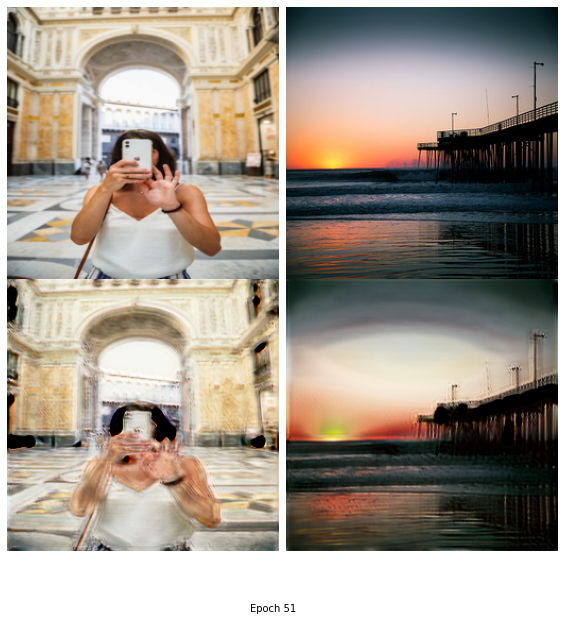

Epoch [51/100], loss_g: 0.9235, loss_d: 0.1395, real_score: 0.8662, fake_score: 0.1461
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


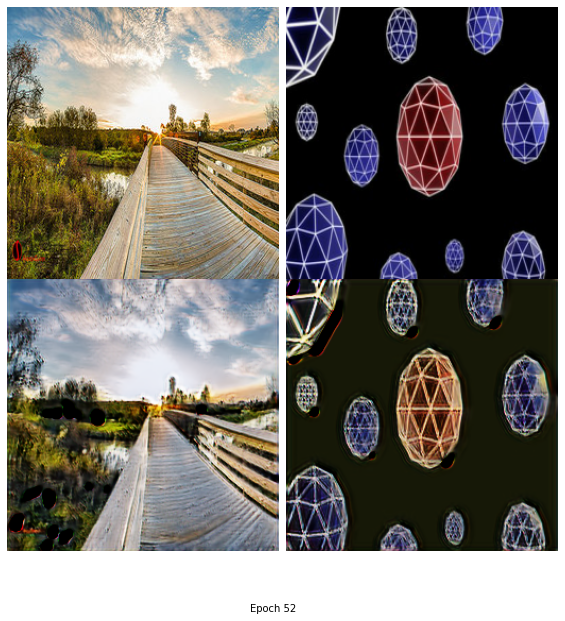

Epoch [52/100], loss_g: 0.9258, loss_d: 0.1568, real_score: 0.8489, fake_score: 0.1520
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


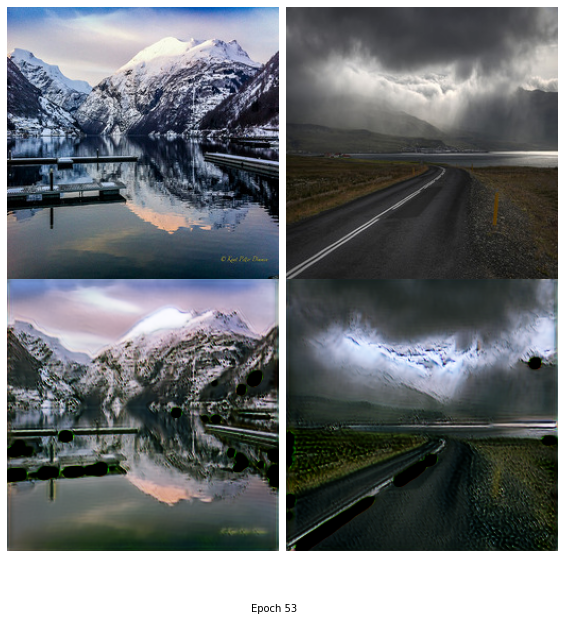

Epoch [53/100], loss_g: 0.9375, loss_d: 0.1127, real_score: 0.8837, fake_score: 0.1227
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


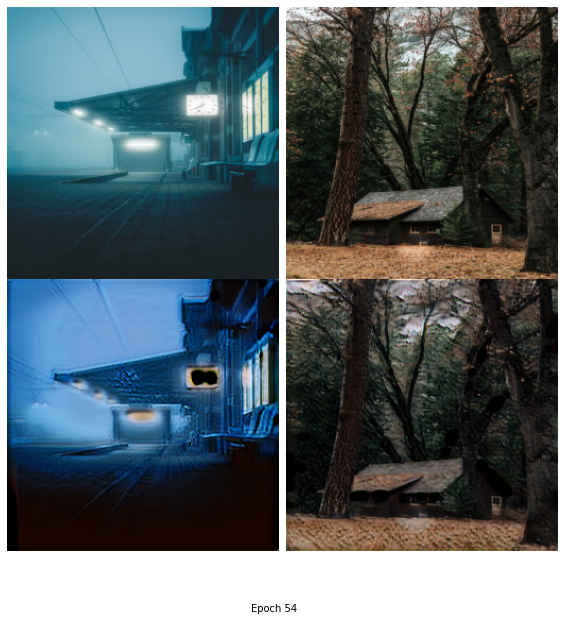

Epoch [54/100], loss_g: 0.9382, loss_d: 0.1087, real_score: 0.8816, fake_score: 0.1177
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


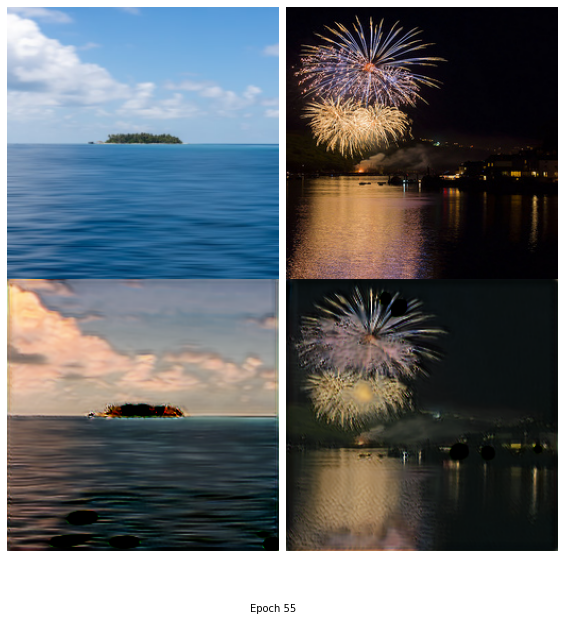

Epoch [55/100], loss_g: 0.9357, loss_d: 0.1257, real_score: 0.8746, fake_score: 0.1259
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


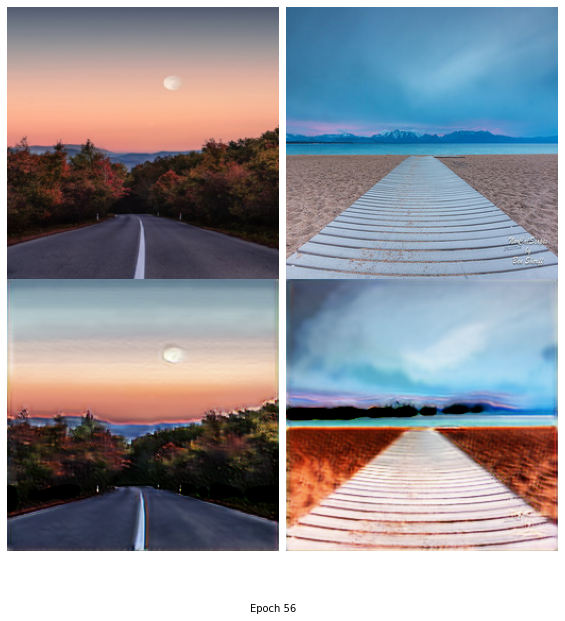

Epoch [56/100], loss_g: 0.9446, loss_d: 0.1291, real_score: 0.8702, fake_score: 0.1222
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


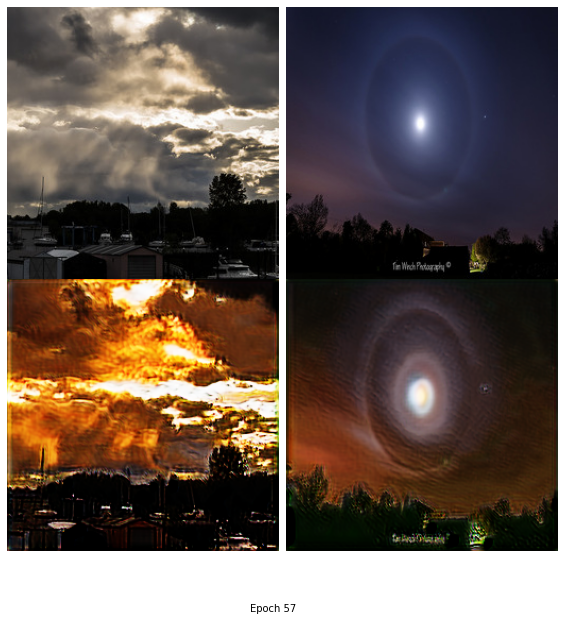

Epoch [57/100], loss_g: 0.9356, loss_d: 0.1426, real_score: 0.8628, fake_score: 0.1368
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


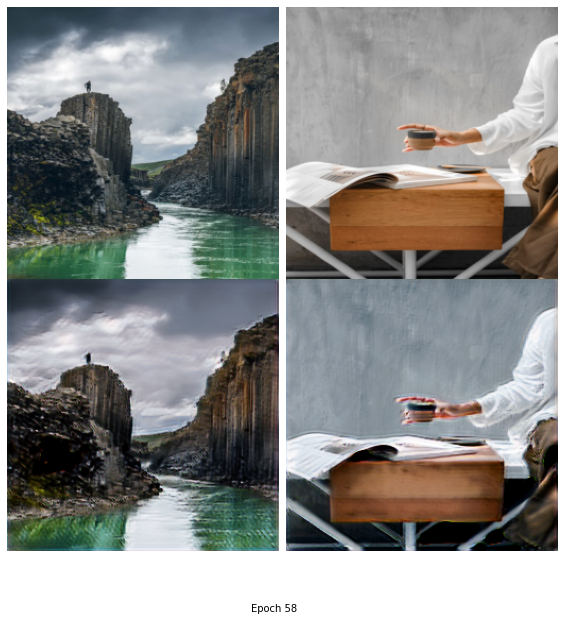

Epoch [58/100], loss_g: 0.9351, loss_d: 0.1272, real_score: 0.8738, fake_score: 0.1285
Batch 0/97
Batch 10/97
Batch 20/97
Batch 30/97
Batch 40/97
Batch 50/97
Batch 60/97
Batch 70/97
Batch 80/97
Batch 90/97


In [ ]:
history = fit(model, criterion, epochs=100, lr=1e-3)

**Экспортируем модель через библиотеку ONNX для инференса в боте, так как в силу ограниченности места на облаке пользоваться библиотекой PyTorch неудобно**

In [7]:
# !pip install onnx

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.5/13.5 MB 95.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 56.6 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.19.6
    Uninstalling protobuf-3.19.6:
      Successfully uninstalled protobuf-3.19.6
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.9.2 requires protobuf<3.20,>=3.9.2, but you have protobuf 3.20.3 which is incompatible.
tensorboard 2.9.1 requires protobuf<3.20,>=3.9.2, but you have protobuf 3.20.3 which is incompatible.


In [8]:
# !pip install onnxruntime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 30.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 KB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 KB 10.8 MB/s eta 0:00:00


In [9]:
discriminator.train(False)
generator.train(False)

Sequential(
  (0): Conv2d(3, 128, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
  (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (2): LeakyReLU(negative_slope=0.01, inplace=True)
  (3): Conv2d(128, 64, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
  (4): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (5): LeakyReLU(negative_slope=0.01, inplace=True)
  (6): Conv2d(64, 64, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
  (7): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (8): LeakyReLU(negative_slope=0.01, inplace=True)
  (9): ConvTranspose2d(64, 64, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
  (10): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (11): LeakyReLU(negative_slope=0.01, inplace=True)
  (12): ConvTranspose2d(64, 128, kernel_size=(5, 5), stride=(1,

In [34]:
# Input to the model
# x = torch.randn(batch_size, 1, 224, 224, requires_grad=True)
torch_out = generator(torch.randn(1, 3, 256, 256, requires_grad=True))

# Export the model
torch.onnx.export(generator,               # model being run
                  torch.randn(1, 3, 256, 256, requires_grad=True),                         # model input (or a tuple for multiple inputs)
                  "/content/drive/MyDrive/DC_GAN/G_B.onnx",   # where to save the model (can be a file or file-like object)
                  export_params=True,        # store the trained parameter weights inside the model file
                  opset_version=10,          # the ONNX version to export the model to
                  do_constant_folding=True,  # whether to execute constant folding for optimization
                  input_names = ['input'],   # the model's input names
                  output_names = ['output'], # the model's output names
                  dynamic_axes={'input' : {0 : 'batch_size'},    # variable length axes
                                'output' : {0 : 'batch_size'}})

/usr/local/lib/python3.8/dist-packages/torch/onnx/symbolic_helper.py:1457: UserWarning: ONNX export mode is set to TrainingMode.EVAL, but operator 'instance_norm' is set to train=True. Exporting with train=True.
  warnings.warn(
